# Imports

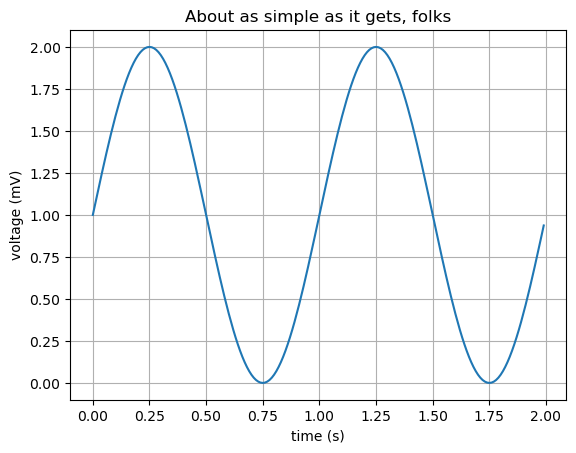

/Users/frank/Dropbox/My Mac (PN115993.campus.nist.gov)/Documents/programming/scattertools/examples/ml/SANS_deep_learning


,setting,value
0,neutron_flux,100000.0
1,beam_area,1
2,beam_center_x,0
3,beam_center_y,0
4,beamstop_diameter,2.54
5,detector_efficiency,1
6,sample_detector_distance,400
7,source_sample_distance,1614
8,source_aperture_radius,0.715
9,sample_aperture_radius,0.635


In [15]:
#This is just to get matplotlib going, which sometimes fails on Windows
import matplotlib.pyplot as plt
import numpy as np

# Data for plotting
t = np.arange(0.0, 2.0, 0.01)
s = 1 + np.sin(2 * np.pi * t)

fig, ax = plt.subplots()
ax.plot(t, s)

ax.set(xlabel='time (s)', ylabel='voltage (mV)',
       title='About as simple as it gets, folks')
ax.grid()

fig.savefig("test.png")
plt.show()

In [2]:
import os
import shutil
import numpy
import pandas

from scattertools.support import molstat
# from molgroups.ml import playground

import pickle
def fnSaveObject(save_object, sFileName):
    with open(sFileName, "wb") as file:
        pickle.dump(save_object, file)

def fnLoadObject(sFileName):
    with open(sFileName, 'rb') as file:
        load_object = pickle.load(file)
    return load_object

# always use the same testdata
shutil.copyfile('./bu/sim.dat', os.getcwd()+'/sim.dat')

'C:\\Users\\Frank Heinrich\\PycharmProjects\\molgroups\\examples\\ml\\EllipsoidProtein_SingleDataset/sim.dat'

# Variables

In [3]:
# Run Optimization or only example fit and data simulation
RunFit=True

# Folders and fit application
store = "T"
setupdir = os.getcwd()
runfile = "ellipsoid"
fitsource = "SASView"

# MCMC fit iterations in example fit and optimization
burn=500
steps=500

# enforced qmin and qmax, even if detector would cover larger q-range
# alternatively: take enforced q-range from first provided data file (index 0)
# set total counting time for the entire experiment (in s), or None
# number of gpcam iterations, if gpcam is used
qmin = 0.01
qmax = 0.8
qrangefromfile = False
t_total = None
optimizer = 'grid'  # optimizer can be 'grid' or gpcam
fitter = 'MCMC'  # fit driver for optimization either 'MCMC' or 'LM'
remove_fit_dir = False # Keep fit directories for inspection of individual simulated fits

# Create Fit Scripts for all Models

1.  The model needs to define fittable parameters with unique names, as shown below. For example, model0.scale and model1.scale would not be unique, since both parameters would be internally named 'scale' by bumps. In such a case, define parameters using the Parameter method and assign them to the models afterwards.

In [4]:
%%writefile ellipsoid.py
from bumps.names import *
from sasmodels.core import load_model
from sasmodels.bumps_model import Model, Experiment
from sasmodels.data import load_data

# IMPORT THE DATA USED
data = load_data('sim.dat')

# DEFINE THE MODEL
kernel = load_model('ellipsoid')

pars = dict(scale=1.0, background=0.0005, sld=3.4, sld_solvent=6.4, radius_polar=14.0,
            radius_equatorial=12.0)

model = Model(kernel, **pars)

# PARAMETER RANGES (ONLY THOSE PARAMETERS ARE FITTED)
model.scale.range(0.001, 0.1)
# model.background.range(0, 1)
model.sld.range(-1, 7)
model.sld_solvent.range(-0.6, 6.4)
model.radius_polar.range(10, 200)
model.radius_equatorial.range(10, 200)

M = Experiment(data=data, model=model)
problem = FitProblem(M)

Overwriting ellipsoid.py


In [5]:
%%writefile sphere.py
from bumps.names import *
from sasmodels.core import load_model
from sasmodels.bumps_model import Model, Experiment
from sasmodels.data import load_data

# IMPORT THE DATA USED
data = load_data('sim.dat')

# DEFINE THE MODEL
kernel = load_model('sphere')

pars = dict(scale=1.0, background=0.0005, sld=3.4, sld_solvent=6.4, radius=14.0)

model = Model(kernel, **pars)

# PARAMETER RANGES (ONLY THOSE PARAMETERS ARE FITTED)
model.scale.range(0.001, 0.1)
# model.background.range(0, 1)
model.sld.range(-1, 7)
model.sld_solvent.range(-0.6, 6.4)
model.radius.range(10, 200)

M = Experiment(data=data, model=model)
problem = FitProblem(M)

Overwriting sphere.py


In [6]:
%%writefile core_shell_sphere.py
from bumps.names import *
from sasmodels.core import load_model
from sasmodels.bumps_model import Model, Experiment
from sasmodels.data import load_data

# IMPORT THE DATA USED
data = load_data('sim.dat')

# DEFINE THE MODEL
kernel = load_model('core_shell_sphere')

pars = dict(scale=1.0, background=0.0005, radius=60., thickness=10., sld_core=3.4, sld_shell=3.5,  sld_solvent=6.4)

model = Model(kernel, **pars)

# PARAMETER RANGES (ONLY THOSE PARAMETERS ARE FITTED)
model.scale.range(0.001, 0.1)
# model.background.range(0, 1)
model.radius.range(10, 200)
model.thickness.range(10., 200.)
model.sld_core.range(-1, 7)
model.sld_shell.range(-1, 7.)
model.sld_solvent.range(-0.6, 6.4)

M = Experiment(data=data, model=model)
problem = FitProblem(M)

Writing core_shell_sphere.py


In [7]:
%%writefile core_shell_ellipsoid.py
from bumps.names import *
from sasmodels.core import load_model
from sasmodels.bumps_model import Model, Experiment
from sasmodels.data import load_data

# IMPORT THE DATA USED
data = load_data('sim.dat')

# DEFINE THE MODEL
kernel = load_model('core_shell_ellipsoid')

pars = dict(scale=1.0, background=0.0005, radius_equat_core=10, x_core=1.5, thick_shell=10, x_polar_shell=1.5, sld_core=3.4, sld_shell=3.5,  sld_solvent=6.4)

model = Model(kernel, **pars)

# PARAMETER RANGES (ONLY THOSE PARAMETERS ARE FITTED)
model.scale.range(0.001, 0.1)
# model.background.range(0, 1)
model.radius_equat_core.range(10, 200)
model.x_core.range(1.0, 10.)
model.thick_shell.range(10., 200.)
model.x_polar_shell.range(1.0, 10.0)
model.sld_core.range(-1, 7)
model.sld_shell.range(-1, 7.)
model.sld_solvent.range(-0.6, 6.4)

M = Experiment(data=data, model=model)
problem = FitProblem(M)

Overwriting core_shell_ellipsoid.py


In [8]:
%%writefile cylinder.py
from bumps.names import *
from sasmodels.core import load_model
from sasmodels.bumps_model import Model, Experiment
from sasmodels.data import load_data

# IMPORT THE DATA USED
data = load_data('sim.dat')

# DEFINE THE MODEL
kernel = load_model('cylinder')

pars = dict(scale=1.0, background=0.0005, sld=3.4, sld_solvent=6.4, radius=14.0,
            length=12.0)

model = Model(kernel, **pars)

# PARAMETER RANGES (ONLY THOSE PARAMETERS ARE FITTED)
model.scale.range(0.001, 0.1)
# model.background.range(0, 1)
model.sld.range(-1, 7)
model.sld_solvent.range(-0.6, 6.4)
model.radius.range(10, 200)
model.length.range(10, 200)

M = Experiment(data=data, model=model)
problem = FitProblem(M)

Overwriting cylinder.py


In [9]:
%%writefile core_shell_cylinder.py
from bumps.names import *
from sasmodels.core import load_model
from sasmodels.bumps_model import Model, Experiment
from sasmodels.data import load_data

# IMPORT THE DATA USED
data = load_data('sim.dat')

# DEFINE THE MODEL
kernel = load_model('core_shell_cylinder')

pars = dict(scale=1.0, background=0.0005, sld_core=3.4, sld_shell=3.4, sld_solvent=6.4, radius=14.0, thickness=10.0,
            length=12.0)

model = Model(kernel, **pars)

# PARAMETER RANGES (ONLY THOSE PARAMETERS ARE FITTED)
model.scale.range(0.001, 0.1)
# model.background.range(0, 1)
model.sld_core.range(-1, 7)
model.sld_shell.range(-1, 7)
model.sld_solvent.range(-0.6, 6.4)
model.radius.range(10, 200)
model.thickness.range(10,200)
model.length.range(10, 200)

M = Experiment(data=data, model=model)
problem = FitProblem(M)

Overwriting core_shell_cylinder.py


In [10]:
%%writefile lamellar.py
from bumps.names import *
from sasmodels.core import load_model
from sasmodels.bumps_model import Model, Experiment
from sasmodels.data import load_data

# IMPORT THE DATA USED
data = load_data('sim.dat')

# DEFINE THE MODEL
kernel = load_model('lamellar')

pars = dict(scale=1.0, background=0.0005, thickness=10.0, sld=3.4, sld_solvent=6.4)

model = Model(kernel, **pars)

# PARAMETER RANGES (ONLY THOSE PARAMETERS ARE FITTED)
model.scale.range(0.001, 0.1)
# model.background.range(0, 1)
model.thickness.range(10,200)
model.sld.range(-1, 7)
model.sld_solvent.range(-0.6, 6.4)

M = Experiment(data=data, model=model)
problem = FitProblem(M)

Overwriting lamellar.py


In [11]:
%%writefile lamellar_hg.py
from bumps.names import *
from sasmodels.core import load_model
from sasmodels.bumps_model import Model, Experiment
from sasmodels.data import load_data

# IMPORT THE DATA USED
data = load_data('sim.dat')

# DEFINE THE MODEL
kernel = load_model('lamellar_hg')

pars = dict(scale=1.0, background=0.0005, length_tail=10.0, length_head=15.0, sld=3.4, sld_head=3.4, sld_solvent=6.4)

model = Model(kernel, **pars)

# PARAMETER RANGES (ONLY THOSE PARAMETERS ARE FITTED)
model.scale.range(0.001, 0.1)
# model.background.range(0, 1)
model.length_tail.range(5., 30.)
model.length_head.range(5., 15.)
model.sld.range(-1, 7)
model.sld_head.range(-1, 7)
model.sld_solvent.range(-0.6, 6.4)

M = Experiment(data=data, model=model)
problem = FitProblem(M)

Overwriting lamellar_hg.py


In [12]:
%%writefile three_pearl_necklace.py
from bumps.names import *
from sasmodels.core import load_model
from sasmodels.bumps_model import Model, Experiment
from sasmodels.data import load_data

# IMPORT THE DATA USED
data = load_data('sim.dat')

# DEFINE THE MODEL
kernel = load_model('pearl_necklace')

pars = dict(scale=1.0, background=0.0005, radius=10.0, edge_sep=350, thick_string=2.5, num_pearls=3, sld=3.4, sld_string=3.4, sld_solvent=6.4)

model = Model(kernel, **pars)

# PARAMETER RANGES (ONLY THOSE PARAMETERS ARE FITTED)
model.scale.range(0.001, 0.1)
# model.background.range(0, 1)
model.radius.range(10, 200.)
model.edge_sep.range(200., 700.)
model.thick_string.range(2., 20.)
model.sld.range(-1, 7)
model.sld_string.range(-1, 7.)
model.sld_solvent.range(-0.6, 6.4)

M = Experiment(data=data, model=model)
problem = FitProblem(M)

Overwriting three_pearl_necklace.py


## Instrument Configuration

In [13]:
sb = 0.059
configuration_dataset1 = [{'lambda': 6.21,
                            "sample_detector_distance": 100,
                            'source_sample_distance': 387.6,
                            'source_aperture_radius':5.08*0.5,
                            'sample_aperture_radius':1.27*0.5,
                            "beamstop_diameter": 10.16,
                            "neutron_flux": 5e4,
                            'time': 1600,
                            'beam_center_x': 25,
                            "dlambda_lambda":0.136,
                            "differential_cross_section_buffer": sb},
                          {'lambda': 6.21,
                           "sample_detector_distance": 400,
                           'source_sample_distance': 850.05,
                           'source_aperture_radius':5.08*0.5,
                           'sample_aperture_radius':1.27*0.5,
                           "beamstop_diameter": 10.16,
                           "neutron_flux": 4e4,
                           'time': 3600,
                           "dlambda_lambda":0.136,
                           "differential_cross_section_buffer": sb},
                         {'lambda': 6.21,
                          "sample_detector_distance": 1300,
                          'source_sample_distance': 1467,
                          'source_aperture_radius':5.08*0.5,
                          'sample_aperture_radius':1.27*0.5,
                          "dlambda_lambda":0.136,
                          "beamstop_diameter": 10.16,
                          "neutron_flux": 4e4,
                          'time': 4400,
                          "differential_cross_section_buffer": sb}]

configuration = [configuration_dataset1]

df = pandas.DataFrame.from_dict(configuration_dataset1)
df

,lambda,sample_detector_distance,source_sample_distance,source_aperture_radius,sample_aperture_radius,beamstop_diameter,neutron_flux,time,beam_center_x,dlambda_lambda,differential_cross_section_buffer
0,6.21,100,387.60,2.54,0.635,10.16,50000.0,1600,25.0,0.136,0.059
1,6.21,400,850.05,2.54,0.635,10.16,40000.0,3600,NaN,0.136,0.059
2,6.21,1300,1467.00,2.54,0.635,10.16,40000.0,4400,NaN,0.136,0.059


# Run Example Fit

In [14]:
fitobj = molstat.CMolStat(
    fitsource=fitsource,
    spath=setupdir,
    mcmcpath=store,
    runfile=runfile,
    state=None,
    problem=None,
)

if RunFit:
    # remove store directory if it already exists, since we do not want to reload here
    if os.path.isdir(os.path.join(setupdir, store)):
        shutil.rmtree(os.path.join(setupdir, store))
    fitobj.Interactor.fnRunMCMC(burn, steps, batch=False)

fitobj.fnRestoreFit()

No file: C:\Users\Frank Heinrich\PycharmProjects\molgroups\examples\ml\EllipsoidProtein_SingleDataset\T\ellipsoid.py
No state to reload.
# steps: 500, # draws: 25000
step 1 cost 16.693(26)
                       radius_equatorial .|........    30.5395 in (10,200)
                            radius_polar |.........    11.4504 in (10,200)
                                   scale ........|.  0.0887343 in (0.001,0.1)
                                     sld ....|.....    2.86704 in (-1,7)
                             sld_solvent ....|.....    2.55559 in (-0.6,6.4)
step 96 cost 1.070(26)
step 193 cost 0.705(26)
step 290 cost 0.705(26)
step 385 cost 0.705(26)
step 480 cost 0.705(26)
step 577 cost 0.705(26)
step 675 cost 0.705(26)
step 772 cost 0.705(26)
step 868 cost 0.699(26)
step 964 cost 0.699(26)
.background = 0.0005
.phi = 60
.phi_pd = 0
.phi_pd_n = 35
.phi_pd_nsigma = 3
.radius_equatorial = 13.4914 in [10,200]
.radius_equatorial_pd = 0
.radius_equatorial_pd_n = 35
.radius_equatorial_pd

## Test Data Simulation
### 1. Show Best-fit parameters from above fit

In [15]:
fitobj.fnLoadParameters()
pf = pandas.DataFrame(fitobj.diParameters)
pf

,radius_equatorial,radius_polar,scale,sld,sld_solvent
number,0,1,2,3,4
lowerlimit,10.0,10.0,0.001,-1.0,-0.6
upperlimit,200.0,200.0,0.1,7.0,6.4
value,13.491355,23.841785,0.071822,5.620665,5.111208
relval,0.018376,0.072851,0.715377,0.827583,0.815887
variable,radius_equatorial,radius_polar,scale,sld,sld_solvent
error,0.01,0.01,0.01,0.01,0.01


2. Define simulation model parameters. They are written out to simpar.dat. Please change to desired values or copy from dataframe above.

In [16]:
simpar = pandas.DataFrame(pf.loc['value'])
simpar.reset_index(inplace=True)
simpar.columns = ['par', 'value']
simpar

,par,value
0,radius_equatorial,13.491355
1,radius_polar,23.841785
2,scale,0.071822
3,sld,5.620665
4,sld_solvent,5.111208


3. Simulate data.

In [17]:
fitobj.fnSimulateData(basefilename='sim.dat', liConfigurations=configuration, qmin=qmin, qmax=qmax, t_total=None, simpar=simpar, average=True)

                 par      value
0  radius_equatorial  13.491355
1       radius_polar  23.841785
2              scale   0.071822
3                sld   5.620665
4        sld_solvent   5.111208
[[{'lambda': 6.21, 'sample_detector_distance': 100, 'source_sample_distance': 387.6, 'source_aperture_radius': 2.54, 'sample_aperture_radius': 0.635, 'beamstop_diameter': 10.16, 'neutron_flux': 50000.0, 'time': 1600, 'beam_center_x': 25, 'dlambda_lambda': 0.136, 'differential_cross_section_buffer': 0.059}, {'lambda': 6.21, 'sample_detector_distance': 400, 'source_sample_distance': 850.05, 'source_aperture_radius': 2.54, 'sample_aperture_radius': 0.635, 'beamstop_diameter': 10.16, 'neutron_flux': 40000.0, 'time': 3600, 'dlambda_lambda': 0.136, 'differential_cross_section_buffer': 0.059}, {'lambda': 6.21, 'sample_detector_distance': 1300, 'source_sample_distance': 1467, 'source_aperture_radius': 2.54, 'sample_aperture_radius': 0.635, 'dlambda_lambda': 0.136, 'beamstop_diameter': 10.16, 'neutron_flux

C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: invalid value encountered in divide
  return (self.theory() - self.Iq) / self.dIq


[[[],
              Q         I        dI        dQ
  31   0.010000  0.032681  0.005342  0.001143
  32   0.010395  0.047545  0.006749  0.001154
  33   0.010806  0.035980  0.006495  0.001165
  34   0.011234  0.038991  0.006251  0.001178
  35   0.011678  0.042484  0.006016  0.001191
  ..        ...       ...       ...       ...
  131  0.483226  0.000635  0.000120  0.027374
  132  0.502333  0.000484  0.000119  0.028415
  133  0.522196  0.000348  0.000145  0.029498
  134  0.542844  0.000180  0.000204  0.030626
  135  0.564308  0.000139  0.000407  0.031799
  
  [105 rows x 4 columns]]]

### Compare original and simulated data.
1. Compare Data

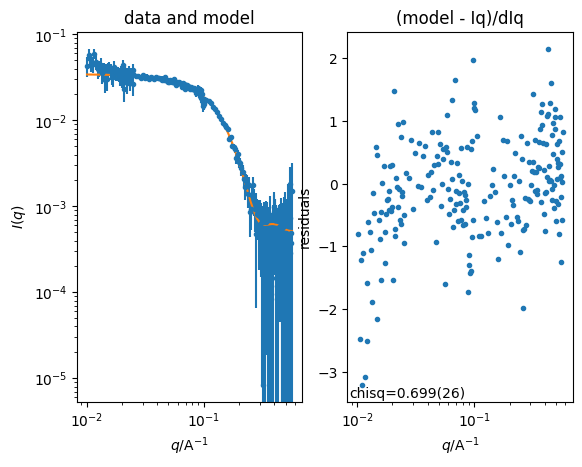

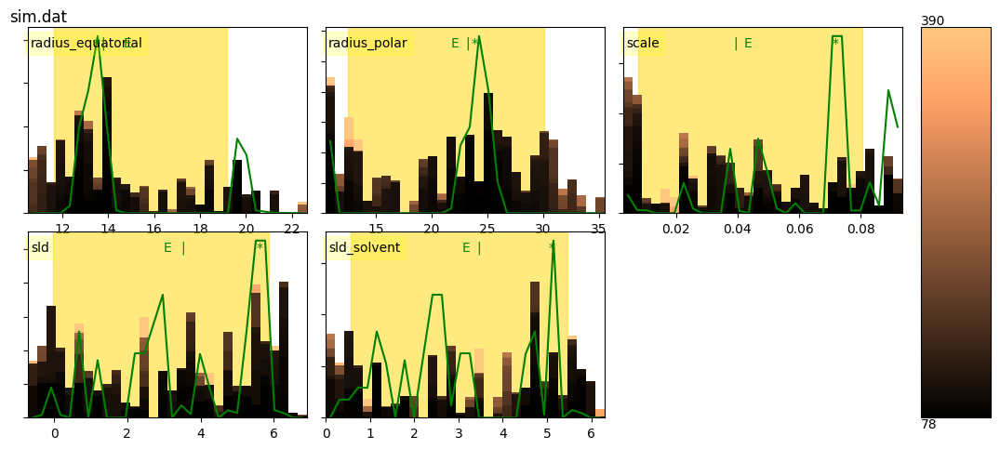

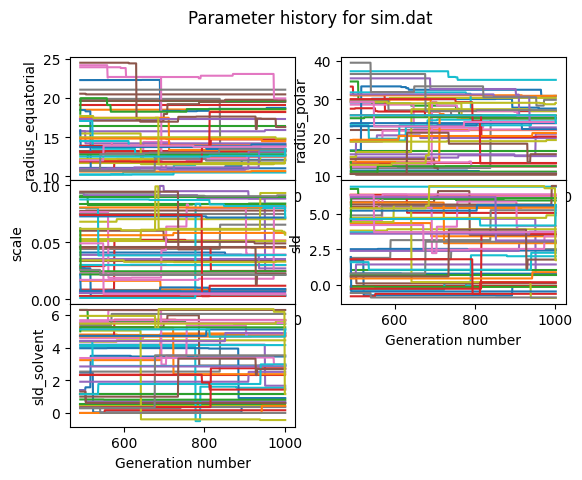

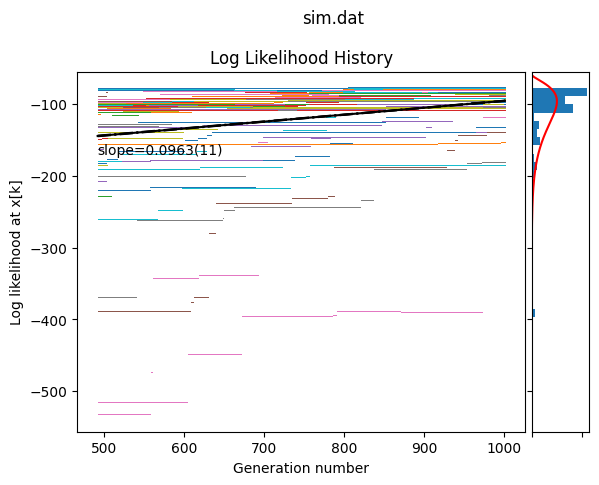

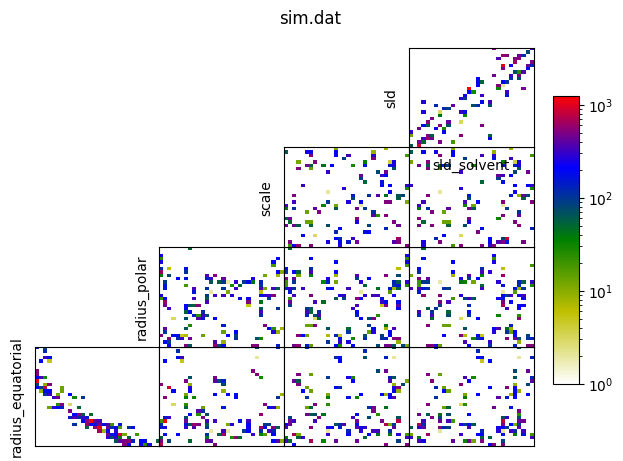

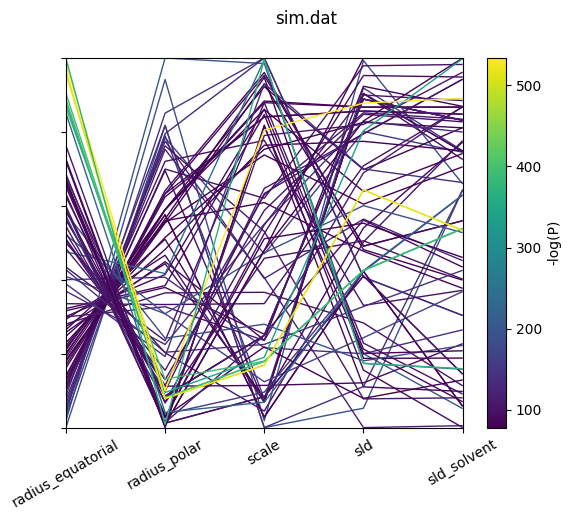

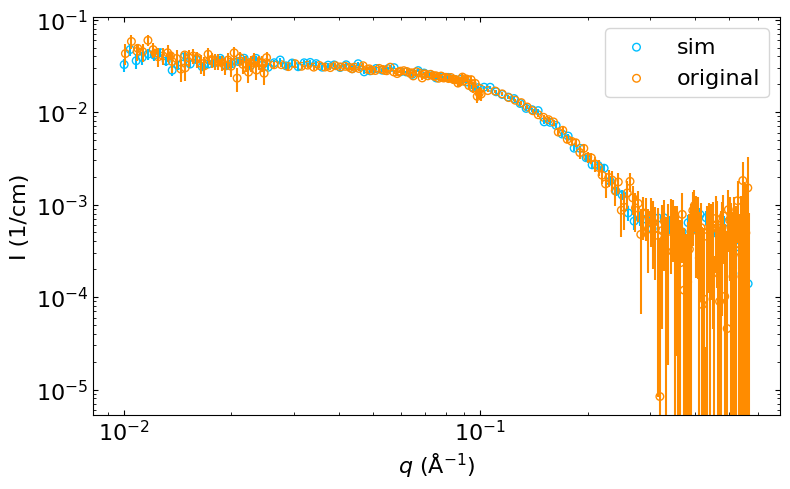

In [18]:
import pandas

fig, ax = plt.subplots()

original = pandas.read_csv('bu/sim.dat', sep=' ', skip_blank_lines=True,comment='#')
simdata = pandas.read_csv('sim.dat', sep=' ', skip_blank_lines=True,comment='#')

ax.errorbar(simdata['Q'], simdata['I'], simdata['dI'], ls='none', color='deepskyblue')
ax.scatter(simdata['Q'], simdata['I'], s=30, marker='o', facecolors='none', edgecolors='deepskyblue', label='sim')
ax.errorbar(original['Q'], original['I'], original['dI'], ls='none', color='darkorange')
ax.scatter(original['Q'], original['I'], s=30, marker='o', facecolors='none', edgecolors='darkorange', label='original')

ax.legend(fontsize=16)
ax.set_ylabel("I (1/cm)", fontsize=16)
ax.set_yscale('log')
ax.set_xscale('log')
ax.minorticks_on()
ax.tick_params(which="both", direction="in", labelsize=16)
ax.tick_params(bottom=True, top=True, left=True, right=True, which="both")
ax.set_xlabel("$q$ (Å$^{-1}$)", fontsize=16)
ax.figure.set_size_inches(8, 5)
#ax.set_ylim(1e-2, .1)
plt.tight_layout()
plt.savefig(store + "/intensity_comparison.png", facecolor="white")
plt.show()


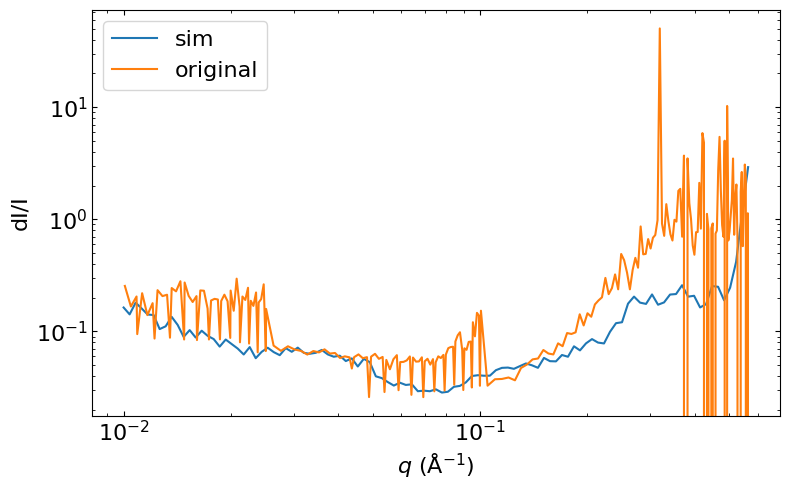

In [19]:
fig, ax = plt.subplots()

#i = 0
#while os.path.isfile('testdata.DAT'):
original = pandas.read_csv('bu/sim.dat', sep=' ', skip_blank_lines=True,comment='#')
simdata = pandas.read_csv('sim.dat', sep=' ', skip_blank_lines=True,comment='#')

ax.plot(simdata['Q'], (simdata['dI']/simdata['I']), label="sim")
ax.plot(original['Q'], (original['dI']/original['I']), label="original")

ax.legend(fontsize=16)
ax.set_ylabel("dI/I", fontsize=16)
ax.set_yscale('log')
ax.set_xscale('log')
ax.minorticks_on()
ax.tick_params(which="both", direction="in", labelsize=16)
ax.tick_params(bottom=True, top=True, left=True, right=True, which="both")
ax.set_xlabel("$q$ (Å$^{-1}$)", fontsize=16)
ax.figure.set_size_inches(8, 5)
#ax.set_ylim(0, 0.25)
plt.tight_layout()
plt.savefig(store + "/uncertainty_comparison.png", facecolor="white")
plt.show()


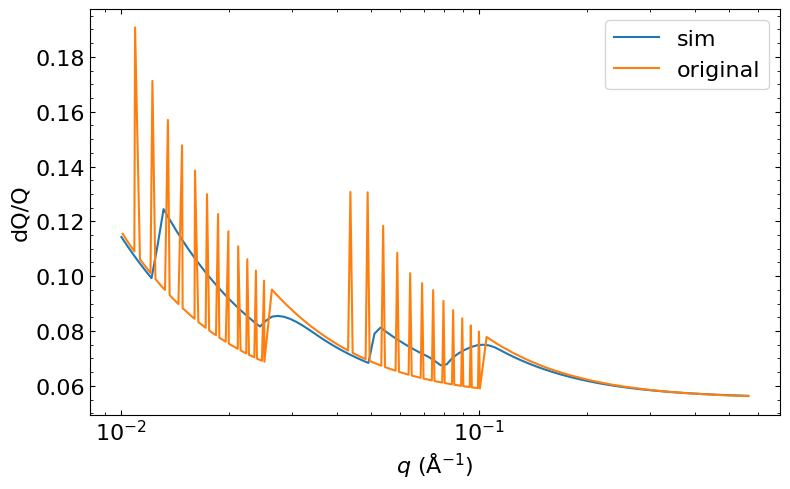

In [20]:
fig, ax = plt.subplots()

#i = 0
#while os.path.isfile('testdata.DAT'):
original = pandas.read_csv('bu/sim.dat', sep=' ', skip_blank_lines=True,comment='#')
simdata = pandas.read_csv('sim.dat', sep=' ', skip_blank_lines=True,comment='#')
ax.plot(simdata['Q'], (simdata['dQ']/simdata['Q']), label="sim")
ax.plot(original['Q'], (original['dQ']/original['Q']), label="original")

ax.legend(fontsize=16)
ax.set_ylabel("dQ/Q", fontsize=16)
ax.set_yscale('linear')
ax.set_xscale('log')
ax.minorticks_on()
ax.tick_params(which="both", direction="in", labelsize=16)
ax.tick_params(bottom=True, top=True, left=True, right=True, which="both")
ax.set_xlabel("$q$ (Å$^{-1}$)", fontsize=16)
ax.figure.set_size_inches(8., 5)
#ax.set_ylim(0, 0.01)
plt.tight_layout()
plt.savefig(store + "/resolution_comparison.png", facecolor="white")
plt.show()


In [21]:
simdata = fitobj.fnSimulateData(basefilename='sim.dat', liConfigurations=configuration, qmin=qmin, qmax=qmax, t_total=None, simpar=simpar, save_file=False, verbose=False, average=True)[0][1]
simdata

C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: invalid value encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: invalid value encountered in divide
  return (self.theory() - self.Iq) / self.dIq


,Q,I,dI,dQ
31,0.010000,0.031931,0.005342,0.001143
32,0.010395,0.035830,0.006749,0.001154
33,0.010806,0.022887,0.006495,0.001165
34,0.011234,0.034449,0.006251,0.001178
35,0.011678,0.031116,0.006016,0.001191
...,...,...,...,...
131,0.483226,0.000373,0.000120,0.027374
132,0.502333,0.000719,0.000119,0.028415
133,0.522196,0.000254,0.000145,0.029498
134,0.542844,0.000369,0.000204,0.030626


# Machine Learning
## Simulate Training Data

In [22]:
def prepare_model(rfile):

    fitobj = molstat.CMolStat(
    fitsource=fitsource,
    spath=setupdir,
    mcmcpath=store,
    runfile=rfile,
    state=None,
    problem=None,
    )

    if os.path.isdir(os.path.join(setupdir, store)):
        shutil.rmtree(os.path.join(setupdir, store))
    fitobj.Interactor.fnRunMCMC(500, 500, batch=False)

    fitobj.fnRestoreFit()

    return fitobj

def simulate_training_data(fitobj, configuration, name, number=10000):

    fitobj.fnRestoreFit()
    fitobj.fnLoadParameters()
    pf = pandas.DataFrame(fitobj.diParameters)

    train_x = []
    train_y = []
    for i in range(number):
        # randomly vary model parameters in fit ranges
        for par in pf:
            pf[par]['value'] = numpy.random.random() * (pf[par]['upperlimit'] - pf[par]['lowerlimit']) + pf[par]['lowerlimit']
        simpar = pandas.DataFrame(pf.loc['value'])
        simpar.reset_index(inplace=True)
        simpar.columns = ['par', 'value']

        # change buffer sb according to solvent sld of water
        cb = 0.9245 - 0.1348 * simpar.loc[simpar.par =='sld_solvent', 'value'].squeeze()
        if 'background' in simpar['par'].values:
            simpar.loc[simpar.par=='background', 'value'] = cb
            for subconfig in configuration[0]:
                subconfig['differential_cross_section_buffer'] = 0
        else:
            for subconfig in configuration[0]:
                subconfig['differential_cross_section_buffer'] = cb

        # simulate data
        simdata = fitobj.fnSimulateData(basefilename='sim.dat', liConfigurations=configuration, qmin=qmin, qmax=qmax, t_total=None, simpar=simpar, verbose=False, average=True)[0][1]

        train_x.append(simdata)
        train_y.append(simpar)

    fnSaveObject(train_x, "training_data/train_"+name+"_x.dat")
    fnSaveObject(train_y, "training_data/train_"+name+"_y.dat")

# modellist = ['sphere', 'core_shell_cylinder', 'core_shell_ellipsoid', 'three_pearl_necklace', 'lamellar']
modellist = ['core_shell_sphere', 'cylinder', 'ellipsoid', 'lamellar_hg']

for model in modellist:
    fitobj = prepare_model(model)
    simulate_training_data(fitobj, configuration, model, number=10000)

No file: C:\Users\Frank Heinrich\PycharmProjects\molgroups\examples\ml\EllipsoidProtein_SingleDataset\T\core_shell_sphere.py
No state to reload.
# steps: 500, # draws: 30000
step 1 cost 634.687(71)
                                  radius ..|.......    64.0108 in (10,200)
                                   scale .|........  0.0116914 in (0.001,0.1)
                                sld_core ......|...    4.23805 in (-1,7)
                               sld_shell ......|...    3.97522 in (-1,7)
                             sld_solvent ......|...    4.16527 in (-0.6,6.4)
                               thickness .........|    193.461 in (10,200)
step 130 cost 0.965(71)
step 260 cost 0.965(71)
step 389 cost 0.965(71)
step 519 cost 0.965(71)
step 649 cost 0.965(71)
step 778 cost 0.965(71)
step 909 cost 0.965(71)
.background = 0.0005
.radius = 14.0461 in [10,200]
.radius_pd = 0
.radius_pd_n = 35
.radius_pd_nsigma = 3
.scale = 0.0374062 in [0.001,0.1]
.sld_core = 1.3042 in [-1,7]
.sld_core_M0 =

C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: invalid value encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: invalid value encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divid

No file: C:\Users\Frank Heinrich\PycharmProjects\molgroups\examples\ml\EllipsoidProtein_SingleDataset\T\cylinder.py
No state to reload.
# steps: 500, # draws: 25000
step 1 cost 21207.192(59)
                                  length .........|    196.118 in (10,200)
                                  radius .....|....    112.646 in (10,200)
                                   scale ...|......  0.0350133 in (0.001,0.1)
                                     sld .....|....    3.52599 in (-1,7)
                             sld_solvent ..|.......    1.36358 in (-0.6,6.4)
step 110 cost 19680.695(59)
step 220 cost 19617.432(59)
step 332 cost 19606.282(59)
step 444 cost 19606.282(59)
step 556 cost 19599.327(59)
step 669 cost 19599.327(59)
step 781 cost 19597.283(59)
step 893 cost 19597.136(59)
.background = 0.0005
.length = 121.146 in [10,200]
.length_pd = 0
.length_pd_n = 35
.length_pd_nsigma = 3
.phi = 60
.phi_pd = 0
.phi_pd_n = 35
.phi_pd_nsigma = 3
.radius = 200 in [10,200]
.radius_pd = 0
.rad

C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: invalid value encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: invalid value encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divid

No file: C:\Users\Frank Heinrich\PycharmProjects\molgroups\examples\ml\EllipsoidProtein_SingleDataset\T\ellipsoid.py
No state to reload.
# steps: 500, # draws: 25000
step 1 cost 2789.177(59)
                       radius_equatorial .......|..    154.506 in (10,200)
                            radius_polar |.........    22.3369 in (10,200)
                                   scale .....|....  0.0576831 in (0.001,0.1)
                                     sld .........|    6.81417 in (-1,7)
                             sld_solvent ......|...    3.66606 in (-0.6,6.4)
step 134 cost 94.780(59)
step 268 cost 91.537(59)
step 404 cost 90.043(59)
step 540 cost 89.909(59)
step 675 cost 89.134(59)
step 811 cost 89.103(59)
step 947 cost 88.741(59)
.background = 0.0005
.phi = 60
.phi_pd = 0
.phi_pd_n = 35
.phi_pd_nsigma = 3
.radius_equatorial = 181.755 in [10,200]
.radius_equatorial_pd = 0
.radius_equatorial_pd_n = 35
.radius_equatorial_pd_nsigma = 3
.radius_polar = 10.0001 in [10,200]
.radius_polar_

C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: invalid value encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: invalid value encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divid

No file: C:\Users\Frank Heinrich\PycharmProjects\molgroups\examples\ml\EllipsoidProtein_SingleDataset\T\lamellar_hg.py
No state to reload.
# steps: 500, # draws: 30000
step 1 cost 7145.655(71)
                             length_head .......|..    12.6999 in (5,15)
                             length_tail .......|..    24.3941 in (5,30)
                                   scale .......|..  0.0722767 in (0.001,0.1)
                                     sld .......|..    5.26607 in (-1,7)
                                sld_head .....|....     3.2019 in (-1,7)
                             sld_solvent ....|.....    2.74269 in (-0.6,6.4)
step 127 cost 6660.871(71)
step 256 cost 6649.114(71)
step 386 cost 6643.151(71)
step 514 cost 6641.374(71)
step 643 cost 6641.374(71)
step 773 cost 6641.374(71)
step 902 cost 6641.374(71)
.background = 0.0005
.length_head = 6.084 in [5,15]
.length_head_pd = 0
.length_head_pd_n = 35
.length_head_pd_nsigma = 3
.length_tail = 21.8691 in [5,30]
.length_tail_pd 

C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: invalid value encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divide by zero encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: invalid value encountered in divide
  return (self.theory() - self.Iq) / self.dIq
C:\bin\anaconda3\envs\NRAnalysis\lib\site-packages\sasmodels\bumps_model.py:243: RuntimeWarning: divid